# Thoth Solver Clustering Python Errors


## Extracting Data from Ceph

In [1]:
from thoth.storages import SolverResultsStore
from dotenv import load_dotenv
load_dotenv()

True

In [2]:
import os

In [3]:
os.environ["THOTH_DEPLOYMENT_NAME"]="ocp4-stage-backup"

In [4]:
import random
import numpy as np
import pandas as pd
import json
from pandas.io.json import json_normalize
import itertools
from nltk.tokenize import RegexpTokenizer
from nltk.corpus import stopwords

RANDOM_SEED = 42
DOC_SAMPLE = 5000
random.seed(RANDOM_SEED)
np.random.seed(RANDOM_SEED)
pd.set_option('display.max_colwidth', -1)

In [5]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/bhaseman/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [6]:
store = SolverResultsStore()
store.connect()

In [7]:
def get_IDs(num_results=1000):
    arr = []
    documents = []
    count = 0
    iterate_results = itertools.islice(store.iterate_results(),num_results)
#     for item in sorted(store.iterate_results(), key=lambda k: random.random()):
    for item in store.iterate_results():
        if item[1]["result"]["errors"] != []:
            print(count, tuple(item)[0])
            arr.append(tuple(item)[0])
            document = store.retrieve_document(tuple(item)[0])
            documents.append(document)
            count += 1
    return arr, documents


In [8]:
def store_IDs(arr):
    with open("Error_Empy_Solver_IDs.txt","w") as file_handler:
        file_handler.write("\n".join(str(item) for item in arr))
    print("done")

In [9]:
def store_solver_docs(considered):
    with open("Error_Empy_Solver_Docs.txt","w") as file_handler:
        file_handler.seek(0)
        file_handler.write(
            '[' +
            ',\n'.join(json.dumps(i) for i in considered) +
            ']\n')

In [10]:
def load_IDs():
    with open("Error_Empy_Solver_IDs.txt","r") as file_reader:
        lines = file_reader.readlines()

    unresolved = []
    for line in lines:
        unresolved.append(line.strip())

In [7]:
def load_docs():
    with open("Error_Empy_Solver_Docs.txt","r") as file_reader:
        data = file_reader.read()

        unresolved = json.loads(data)
        return unresolved

In [7]:
arr = []
documents = []
count = 0
# for item in sorted(store.iterate_results(), key=lambda k: random.random()):
for item in store.iterate_results():
    if item[1]["result"]["errors"] != []:
        print(count, tuple(item)[0])
        arr.append(tuple(item)[0])
        document = store.retrieve_document(tuple(item)[0])
        documents.append(document)
        count += 1

0 solver-fedora-31-py37-001943ab
1 solver-fedora-31-py37-001d3501
2 solver-fedora-31-py37-0022caa4
3 solver-fedora-31-py37-00256a89
4 solver-fedora-31-py37-00280e59
5 solver-fedora-31-py37-003d9de4
6 solver-fedora-31-py37-004344f0
7 solver-fedora-31-py37-005ab6b4
8 solver-fedora-31-py37-0063867d
9 solver-fedora-31-py37-0071df0b
10 solver-fedora-31-py37-007b905b
11 solver-fedora-31-py37-0080138b
12 solver-fedora-31-py37-008441f2
13 solver-fedora-31-py37-0084da4c
14 solver-fedora-31-py37-008fb9cd
15 solver-fedora-31-py37-00912d02
16 solver-fedora-31-py37-0095681b
17 solver-fedora-31-py37-0099ab93


KeyboardInterrupt: 

In [ ]:
store_IDs(arr)

In [ ]:
store_solver_docs(documents)

In [14]:
considered_id = unresolved
considered = []
considered_result = []
considered_metadata = []
for item in considered_id:
    document = store.retrieve_document(item)
    result = document["result"]
    metadata = document["metadata"]
    considered_result.append(result)
    considered_metadata.append(metadata)
    considered.append(document)

In [8]:
unresolved = load_docs()

{'metadata': {'analyzer': 'thoth-solver', 'analyzer_version': '1.6.2', 'arguments': {'python': {'exclude_packages': None, 'index': 'https://pypi.org/simple', 'no_pretty': False, 'no_transitive': True, 'output': '/mnt/workdir/solver-fedora-31-py37-001943ab', 'requirements': 'mpi4py===0.4.0rc2', 'virtualenv': '/home/solver/venv'}, 'thoth-solver': {'verbose': False}}, 'datetime': '2020-10-02T01:55:08.555072', 'distribution': {'codename': '', 'id': 'fedora', 'like': '', 'version': '31', 'version_parts': {'build_number': '', 'major': '31', 'minor': ''}}, 'document_id': 'solver-fedora-31-py37-001943ab', 'duration': 3, 'hostname': 'solver-fedora-31-py37-001943ab-1350312170', 'os_release': {'id': 'fedora', 'name': 'Fedora', 'platform_id': 'platform:f31', 'redhat_bugzilla_product': 'Fedora', 'redhat_bugzilla_product_version': '31', 'redhat_support_product': 'Fedora', 'redhat_support_product_version': '31', 'variant_id': 'container', 'version': '31 (Container Image)', 'version_id': '31'}, 'pytho

In [9]:
random.shuffle(unresolved)  # shuffle IDs

In [10]:
from pandas.io.json import json_normalize

In [11]:
df = json_normalize(unresolved, sep = "_")
df.head()

metadata_analyzer metadata_analyzer_version  \
0  thoth-solver      1.6.3                      
1  thoth-solver      1.6.0                      
2  thoth-solver      1.6.2                      
3  thoth-solver      1.6.3                      
4  thoth-solver      1.6.3                      

  metadata_arguments_cli.py_verbose  \
0  NaN                                
1  NaN                                
2  NaN                                
3  NaN                                
4  NaN                                

  metadata_arguments_python_exclude_packages  \
0  None                                        
1  None                                        
2  None                                        
3  None                                        
4  None                                        

                                                                                                                                                                                                                                                                                         metadata_arguments_python_index  \
0  https://pypi.org/simple                                                                                                                                                                                                                                                                                                 
1  https://tensorflow.pypi.thoth-station.ninja/index/rhel7.7/AVX2/simple,https://tensorflow.pypi.thoth-station.ninja/index/rhel7.6/AVX2/simple,https://tensorflow.pypi.thoth-station.ninja/index/manylinux2010/AVX2/simple,https://tensorflow.pypi.thoth-station.ninja/index/rhel7.5/AVX2/simple,https://pypi.org/simple   
2  https://pypi.org/simple                                                                                                                                                                                                                                                                                                 
3  https://pypi.org/simple                                                                                                                                                                                                                                                                                                 
4  https://pypi.org/simple                                                                                                                                                                                                                                                                                                 

   metadata_arguments_python_no_pretty  \
0  False                                 
1  False                                 
2  False                                 
3  False                                 
4  False                                 

   metadata_arguments_python_no_transitive  \
0  True                                      
1  True                                      
2  True                                      
3  True                                      
4  True                                      

                                   metadata_arguments_python_output  \
0  /mnt/workdir/solver-fedora-32-py38-210219171525-e2c58d22c305cba3   
1  /mnt/workdir/solver-fedora-31-py38-23a399e1                        
2  /mnt/workdir/solver-fedora-31-py38-885e7a41                        
3  /mnt/workdir/solver-fedora-32-py37-210215001048-e7a8f2434c81bd8e   
4  /mnt/workdir/solver-fedora-32-py37-c70ca52d                        

  metadata_arguments_python_requirements metadata_arguments_python_virtualenv  \
0  cupy-cuda80===4.4.0                    /home/solver/venv                     
1  catboost===0.1.1                       /home/solver/venv                     
2  sure===1.1.0                           /home/solver/venv                     
3  ac

## Preprocess error logs

In [12]:
def split_text(text):
    new_text = text.split('\n')
    return new_text

def get_ERROR(text):
    value = "Command exited with non-zero status code (1):"
    if value in text:
        text = text.replace(value, "")
    text = ' '.join(text.split())
    return text

In [13]:
df_errors = pd.DataFrame()
df_errors['result_errors'] = df['result_errors']
df_errors['message'] = df_errors.apply(lambda row: row.result_errors[0]['details']['message'], axis=1)
df_errors['tokenized_message'] = df_errors.apply(lambda row: split_text(row.message),axis = 1)
df_errors['exit_status'] = df_errors.apply(lambda row: row.tokenized_message[0],axis = 1)
df_errors['exit_status_ERROR'] = df_errors.apply(lambda row: get_ERROR(row.exit_status), axis = 1)
df_errors['command'] = df_errors["tokenized_message"].str[1]
df_errors['ERROR'] = df_errors["tokenized_message"].str[-2]
df_errors['error_info'] = df_errors["tokenized_message"].str[-4]
df_errors['error_label'] = df_errors["tokenized_message"].str[-5]
df_errors['cwd_info'] = df_errors["tokenized_message"].str[2:-6]
df_errors['error_for_analysis'] = df_errors['error_info'] + df_errors['error_label']
df_errors.head()

result_errors  \
0  [{'details': {'command': '/home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps cupy-cuda80===4.4.0 --index-url "https://pypi.org/simple"  --trusted-host pypi.org', 'message': 'Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement cupy-cuda80===4.4.0 (from versions: 6.6.0, 6.7.0, 7.0.0, 7.1.0, 7.1.1, 7.2.0, 7.3.0, 7.4.0, 7.5.0, 7.6.0, 7.7.0, 7.8.0, 8.0.0a1, 8.0.0b1, 8.0.0b2, 8.0.0b3, 8.0.0b4)
ERROR: No matching distribution found for cupy-cuda80===4.4.0
WARNING: You are using pip version 20.2.4; however, version 21.0.1 is available.
You should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command.
', 'return_code': 1, 'stderr': 'ERROR: Could not find a version that satisfies the requirement cupy-cuda80===4.4.0 (from versions: 6.6.0, 6.7.0, 7.0.0, 7.1.0, 7.1.1, 7.2.0, 7.3.0, 7.4.0, 7.5.0, 7.6.0, 7.7.0, 7.8.0, 8.0.0a1, 8.0.0b1, 8.0.0b2, 8.0.0b3, 8.0.0b4)
ERROR: No matching distribution found for cupy-cuda80===4.4.0
WARNING: You are using pip version 20.2.4; however, version 21.0.1 is available.
You should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command.
', 'stdout': '', 'timeout': 60}, 'index_url': 'https://pypi.org/simple', 'is_provided_package': True, 'is_provided_package_version': True, 'package_name': 'cupy-cuda80', 'package_version': '4.4.0', 'type': 'command_error'}]                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                              

In [45]:
def process_exit_status_ERROR(text):
    if "ERROR:" in text:
        text = text.replace("ERROR: ", "")
    if "Command errored out with exit status 1:" in text:
        text = text.replace("Command errored out with exit status 1:", "exitStatus1")
    if "Could not find a version that satisfies the requirement" in text:
        text = text.replace("Could not find a version that satisfies the requirement", "CouldNotFindVersionRequirement")
    if "Failed to successfully execute function" in text:
        text = text.replace("Failed to successfully execute function in Python interpreter", "FailedToExcecuteFunction/Module")
    if " (from versions:" in text:
        text = text.split(" (from versions:")
    
    if len(text) == 2:
        text = text[0]
    return text

def process_error_info(text):
    if isinstance(text, str):
        text = ' '.join(text.split())
        if "ERROR:" in text:
            text = text.replace("ERROR: ", "")
        if " [Errno 2] No such file or directory: " in text:
            text = text.replace(" [Errno 2] No such file or directory: ", "DirectoryNotFound: ")
        if "NameError:" in text:
            text = text.replace(" name ", " ")
            text = text.replace(" is not defined", "")
        if "ModuleNotFoundError:" in text:
            text = text.replace("No module named ", "")
        if "Check the logs" in text:
            text = text.replace("Check the logs for full command output.", "CheckTheLogs")
        if "No matching distribution found" in text:
            text = text.replace("No matching distribution found", "NoMatchingDistributionError")
    return text

def check_is_instance(text):
    if not isinstance(text, str):
        text = ""
        
    return text

In [15]:
#Stopwords
def remove_stopwords(text):
    text = text.split()
    words = [w for w in text if w not in stopwords.words('english')]
    return " ".join(words)


In [46]:
df_errors['exit_status_ERROR_processed'] = df_errors.apply(lambda row: process_exit_status_ERROR(row.exit_status_ERROR),axis = 1)
df_errors['error_info_processed'] = df_errors.apply(lambda row: process_error_info(row.error_info),axis = 1)
df_errors["message_processed"] = df_errors["exit_status_ERROR_processed"] + " " + df_errors["error_info_processed"]
df_errors["message_processed"] = df_errors.apply(lambda row: check_is_instance(row.message_processed),axis = 1)
df_errors["message_processed"] = df_errors.apply(lambda row: remove_stopwords(row.message_processed),axis = 1)

In [47]:
df_errors = df_errors[:5000]  # smaller sample

In [48]:
df_errors['message_processed'].head()

0    CouldNotFindVersionRequirement cupy-cuda80===4.4.0 NoMatchingDistributionError cupy-cuda80===4.4.0                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                               
1    CouldNotFindVersionRequirement catboost===0.1.1 NoMatchingDistributionError catboost===0.1.1                                                                                                                                                                                                                                                                                                

## Clustering

In [49]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [50]:
vectorizer = TfidfVectorizer(stop_words={'english'})
X = vectorizer.fit_transform(df_errors['message_processed'])
x_arr = X.toarray()

In [51]:
import matplotlib.pyplot as plt

In [52]:
from scipy.cluster.hierarchy import dendrogram, linkage, cophenet
from scipy.spatial.distance import pdist

In [53]:
print(X.shape)
Z = linkage(x_arr, 'ward')

(5000, 3530)


In [54]:
c, coph_dists = cophenet(Z, pdist(x_arr))
c

0.6396442213401596

In [55]:
plt.rcParams.update({'font.size': 22})

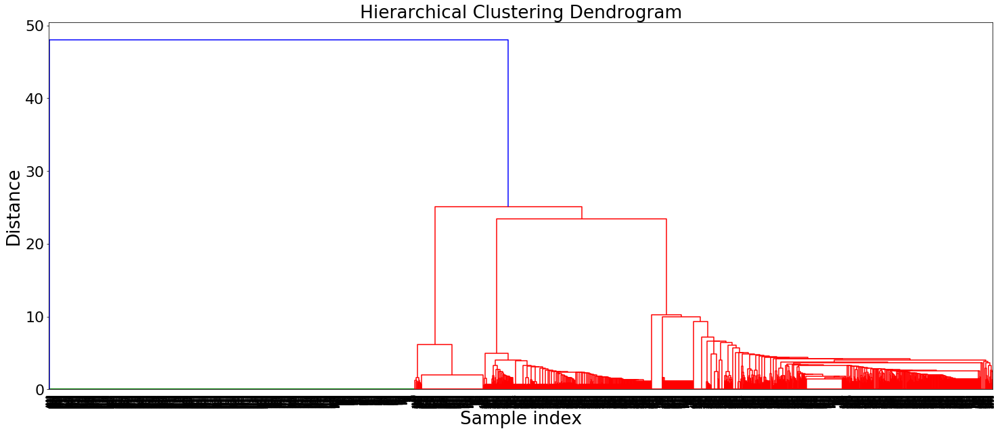

In [31]:
# calculate full dendrogram
plt.figure(figsize=(25, 10))
plt.title('Hierarchical Clustering Dendrogram', fontsize='large')
plt.xlabel('Sample index', fontsize='large')
plt.ylabel('Distance', fontsize='large')
dendrogram(
    Z,
    leaf_rotation=90.,  
    leaf_font_size=8.,  
)
plt.show()

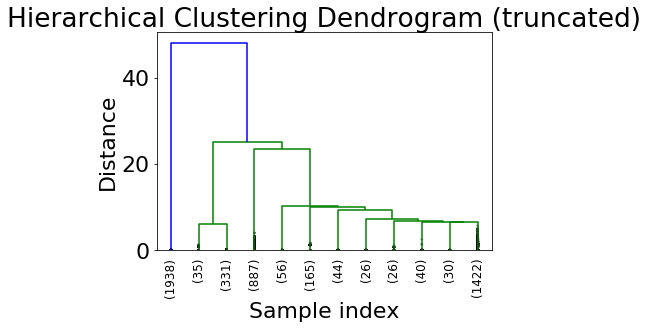

In [32]:
plt.title('Hierarchical Clustering Dendrogram (truncated)')
plt.xlabel('Sample index')
plt.ylabel('Distance')
dendrogram(
    Z,
    truncate_mode='lastp',  # show only the last p merged clusters
    p=12,  # show only the last p merged clusters
    leaf_rotation=90.,
    leaf_font_size=12.,
    show_contracted=True,  
)
plt.show()

In [56]:
from scipy.cluster.hierarchy import fcluster
max_d = 7
clusters = fcluster(Z, max_d, criterion='distance')

In [57]:
clusters

array([8, 8, 1, ..., 1, 2, 1], dtype=int32)

In [58]:
#The number of unique clusters identified by the algorithm
set(clusters)

{1, 2, 3, 4, 5, 6, 7, 8}

In [59]:
def get_data_from_cluster(df, clusters, cluster_number):
    indices = [i for i, x in enumerate(clusters) if x == cluster_number]
    df_grouped = df.iloc[indices]
    return df_grouped

In [60]:
get_data_from_cluster(df_errors, clusters, 1).head()

result_errors  \
2  [{'details': {'command': '/home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps sure===1.1.0 --index-url "https://pypi.org/simple"  --trusted-host pypi.org', 'message': 'Command exited with non-zero status code (1):     ERROR: Command errored out with exit status 1:
     command: /home/solver/venv/bin/python3 -c 'import sys, setuptools, tokenize; sys.argv[0] = '"'"'/tmp/pip-install-a7v52shz/sure/setup.py'"'"'; __file__='"'"'/tmp/pip-install-a7v52shz/sure/setup.py'"'"';f=getattr(tokenize, '"'"'open'"'"', open)(__file__);code=f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' egg_info --egg-base /tmp/pip-pip-egg-info-u8zwu7ik
         cwd: /tmp/pip-install-a7v52shz/sure/
    Complete output (8 lines):
    Traceback (most recent call last):
      File "<string>", line 1, in <module>
      File "/tmp/pip-install-a7v52shz/sure/setup.py", line 20, in <module>
        from sure import version
      File "/tmp/pip-install-a7v52shz/sure/sure/__init__.py", line 164
        except TypeError, e:
                        ^
    SyntaxError: invalid syntax
    ----------------------------------------
ERROR: Command errored out with exit status 1: python setup.py egg_info Check the logs for full command output.
WARNING: You are using pip version 20.2.2; however, version 20.2.3 is available.
You should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command.
', 'return_code': 1, 'stderr': '    ERROR: Command errored out with exit status 1:
     command: /home/solver/venv/bin/python3 -c 'import sys, setuptools, tokenize; sys.argv[0] = '"'"'/tmp/pip-install-a7v52shz/sure/setup.py'"'"'; __file__='"'"'/tmp/pip-install-a7v52shz/sure/setup.py'"'"';f=getattr(tokenize, '"'"'open'"'"', open)(__file__);code=f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' egg_info --egg-base /tmp/pip-pip-egg-info-u8zwu7ik
         cwd: /tmp/pip-install-a7v52shz/sure/
    Complete output (8 lines):
    Traceback (most recent call last):
      File "<string>", line 1, in <module>
      File "/tmp/pip-install-a7v52shz/sure/setup.py", line 20, in <module>
        from sure import version
      File "/tmp/pip-install-a7v52shz/sure/sure/__init__.py", line 164
        except TypeError, e:
                        ^
    SyntaxError: invalid syntax
    ----------------------------------------
ERROR: Command errored out with exit status 1: python setup.py egg_info Check the logs for full command output.
WARNING: You are using pip version 20.2.2; however, version 20.2.3 is available.
You should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command.
', 'stdout': 'Collecting sure===1.1.0
  Downloading sure-1.1.0.tar.gz (10 kB)
', 'timeout': 60}, 'index_url': 'https://pypi.org/simple', 'is_provided_package': True, 'is_provided_package_version': True, 'package_name': 'sure', 'package_version': '1.1.0', 'type': 'command_error'}]                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          

In [61]:
get_data_from_cluster(df_errors, clusters, 2).head()

,result_errors,message,tokenized_message,exit_status,exit_status_ERROR,command,ERROR,error_info,error_label,cwd_info,error_for_analysis,exit_status_ERROR_processed,error_info_processed,message_processed
30,"[{'details': {'message': 'Failed to successfully execute function in Python interpreter: Traceback (most recent call last): File ""<string>"", line 21, in <module> File ""<string>"", line 8, in _find_distribution_name File ""/home/solver/venv/lib/python3.7/site-packages/pkg_resources/__init__.py"", line 1696, in <module> register_loader_type(importlib_bootstrap.SourceFileLoader, DefaultProvider) AttributeError: module 'importlib._bootstrap' has no attribute 'SourceFileLoader' '}, 'index_url': 'https://pypi.org/simple', 'is_provided_package': True, 'is_provided_package_version': True, 'package_name': 'setuptools', 'package_version': '12.0', 'type': 'command_error'}]","Failed to successfully execute function in Python interpreter: Traceback (most recent call last):\n File ""<string>"", line 21, in <module>\n File ""<string>"", line 8, in _find_distribution_name\n File ""/home/solver/venv/lib/python3.7/site-packages/pkg_resources/__init__.py"", line 1696, in <module>\n register_loader_type(importlib_bootstrap.SourceFileLoader, DefaultProvider)\nAttributeError: module 'importlib._bootstrap' has no attribute 'SourceFileLoader'\n","[Failed to successfully execute function in Python interpreter: Traceback (most recent call last):, File ""<string>"", line 21, in <module>, File ""<string>"", line 8, in _find_distribution_name, File ""/home/solver/venv/lib/python3.7/site-packages/pkg_resources/__init__.py"", line 1696, in <module>, register_loader_type(importlib_bootstrap.SourceFileLoader, DefaultProvider), AttributeError: module 'importlib._bootstrap' has no attribute 'SourceFileLoader', ]",Failed to successfully execute function in Python interpreter: Traceback (most recent call last):,Failed to successfully execute function in Python interpreter: Traceback (most recent call last):,"File ""<string>"", line 21, in <module>",AttributeError: module 'importlib._bootstrap' has no attribute 'SourceFileLoader',"File ""/home/solver/venv/lib/python3.7/site-packages/pkg_resources/__init__.py"", line 1696, in <module>","File ""<string>"", line 8, in _find_distribution_name",[],"File ""/home/solver/venv/lib/python3.7/site-packages/pkg_resources/__init__.py"", line 1696, in <module> File ""<string>"", line 8, in _find_distribution_name",FailedToExcecuteModuleError: Traceback (most recent call last):,"File ""/home/solver/venv/lib/python3.7/site-packages/pkg_resources/__init__.py"", line 1696, in <module>","FailedToExcecuteModuleError: Traceback (most recent call last): File ""/home/solver/venv/lib/python3.7/site-packages/pkg_resources/__init__.py"", line 1696, <module>"
40,"[{'details': {'message': 'Failed to successfully execute function in Python interpreter: Traceback (most recent call last): File ""<string>"", line 5, in _get_importlib_metadata_metadata ModuleNotFoundError: No module named 'importlib_metadata' During handling of the above exception, another exception occurred: Traceback (most recent call last): File ""<string>"", line 38, in <module> File ""<string>"", line 7, in _get_importlib_metadata_metadata ModuleNotFoundError: No module named 'importlib.metadata' '}, 'index_url': 'https://pypi.org/simple', 'is_provided_package': True, 'is_provided_package_version': True, 'package_name': 'boto3', 'package_version': '1.12.37', 'type': 'command_error'}]","Failed to successfully execute function in Python interpreter: Traceback (most recent call last):\n File ""<string>"", line 5, in _get_importlib_metadata_metadata\nModuleNotFoundError: No module named 'importlib_metadata'\n\nDuring handling of the above exception, another exception occurred:\n\nTraceback (most recent call last):\n File ""<string>"", line 38, in <module>\n File ""<string>"", line 7, in _get_importlib_metadata_metadata\nModuleNotFoundError: No module named 'importlib.metad

In [62]:
get_data_from_cluster(df_errors, clusters, 3).head()

result_errors  \
3   [{'details': {'command': '/home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps accesscontrol===2.13.8 --index-url "https://pypi.org/simple"  --trusted-host pypi.org', 'message': 'Command exited with non-zero status code (1):   ERROR: Command errored out with exit status 1:
   command: /home/solver/venv/bin/python3 -u -c 'import sys, setuptools, tokenize; sys.argv[0] = '"'"'/tmp/pip-install-uqoq39_k/accesscontrol/setup.py'"'"'; __file__='"'"'/tmp/pip-install-uqoq39_k/accesscontrol/setup.py'"'"';f=getattr(tokenize, '"'"'open'"'"', open)(__file__);code=f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' bdist_wheel -d /tmp/pip-wheel-i0a83ysf
       cwd: /tmp/pip-install-uqoq39_k/accesscontrol/
  Complete output (96 lines):
  running bdist_wheel
  running build
  running build_py
  creating build
  creating build/lib.linux-x86_64-3.7
  creating build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/__init__.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/AuthEncoding.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/class_init.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/DTML.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/ImplC.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/Implementation.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/ImplPython.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/interfaces.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/logger_wrapper.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/metaconfigure.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/Owned.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/owner.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/Permission.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/PermissionMapping.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/PermissionRole.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/Permissions.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/requestmethod.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/Role.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/rolemanager.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/security.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/SecurityInfo.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/SecurityManagement.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/SecurityManager.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/SimpleObjectPolicies.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/SpecialUsers.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/tainted.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/unauthorized.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/User.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/userfolder.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/users.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/ZopeGuards.py -> build/lib.linux-x86_64-3.7/AccessControl
  copying src/AccessControl/ZopeSecurityPolicy.py -> build/lib.linux-x86_64-3.7/AccessControl
  creating build/lib.linux-x86_64-3.7/AccessControl/tests
  copying src/AccessControl/tests/__init__.py -> build/lib.linux-x86_64-3.7/AccessControl/tests
  copying src/AccessControl/tests/actual_python.py -> build/lib.linux-x

In [63]:
get_data_from_cluster(df_errors, clusters, 4).head()

,result_errors,message,tokenized_message,exit_status,exit_status_ERROR,command,ERROR,error_info,error_label,cwd_info,error_for_analysis,exit_status_ERROR_processed,error_info_processed,message_processed
83,"[{'details': {'command': '/home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps abracadabra===0.0.4 --index-url ""https://pypi.org/simple"" --trusted-host pypi.org', 'message': 'Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement abracadabra===0.0.4 (from versions: 0.0.2.macosx-10.14-x86_64, 0.0.3.macosx-10.14-x86_64, 0.0.4.macosx-10.14-x86_64, 0.0.5.macosx-10.14-x86_64, 0.0.0, 0.0.1, 0.0.5, 0.0.6) ERROR: No matching distribution found for abracadabra===0.0.4 WARNING: You are using pip version 20.2.4; however, version 21.0.1 is available. You should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command. ', 'return_code': 1, 'stderr': 'ERROR: Could not find a version that satisfies the requirement abracadabra===0.0.4 (from versions: 0.0.2.macosx-10.14-x86_64, 0.0.3.macosx-10.14-x86_64, 0.0.4.macosx-10.14-x86_64, 0.0.5.macosx-10.14-x86_64, 0.0.0, 0.0.1, 0.0.5, 0.0.6) ERROR: No matching distribution found for abracadabra===0.0.4 WARNING: You are using pip version 20.2.4; however, version 21.0.1 is available. You should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command. ', 'stdout': '', 'timeout': 60}, 'index_url': 'https://pypi.org/simple', 'is_provided_package': True, 'is_provided_package_version': True, 'package_name': 'abracadabra', 'package_version': '0.0.4', 'type': 'command_error'}]","Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement abracadabra===0.0.4 (from versions: 0.0.2.macosx-10.14-x86_64, 0.0.3.macosx-10.14-x86_64, 0.0.4.macosx-10.14-x86_64, 0.0.5.macosx-10.14-x86_64, 0.0.0, 0.0.1, 0.0.5, 0.0.6)\nERROR: No matching distribution found for abracadabra===0.0.4\nWARNING: You are using pip version 20.2.4; however, version 21.0.1 is available.\nYou should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command.\n","[Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement abracadabra===0.0.4 (from versions: 0.0.2.macosx-10.14-x86_64, 0.0.3.macosx-10.14-x86_64, 0.0.4.macosx-10.14-x86_64, 0.0.5.macosx-10.14-x86_64, 0.0.0, 0.0.1, 0.0.5, 0.0.6), ERROR: No matching distribution found for abracadabra===0.0.4, WARNING: You are using pip version 20.2.4; however, version 21.0.1 is available., You should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command., ]","Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement abracadabra===0.0.4 (from versions: 0.0.2.macosx-10.14-x86_64, 0.0.3.macosx-10.14-x86_64, 0.0.4.macosx-10.14-x86_64, 0.0.5.macosx-10.14-x86_64, 0.0.0, 0.0.1, 0.0.5, 0.0.6)","ERROR: Could not find a version that satisfies the requirement abracadabra===0.0.4 (from versions: 0.0.2.macosx-10.14-x86_64, 0.0.3.macosx-10.14-x86_64, 0.0.4.macosx-10.14-x86_64, 0.0.5.macosx-10.14-x86_64, 0.0.0, 0.0.1, 0.0.5, 0.0.6)",ERROR: No matching distribution found for abracadabra===0.0.4,You should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command.,ERROR: No matching distribution found for abracadabra===0.0.4,"Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement abracadabra===0.0.4 (from versions: 0.0.2.macosx-10.14-x86_64, 0.0.3.macosx-10.14-x86_64, 0.0.4.macosx-10.14-x86_64, 0.0.5.macosx-10.14-x86_64, 0.0.0, 0.0.1, 0.0.5, 0.0.6)",[],"ERROR: No matching distribution found for abracadabra===0.0.4Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement abracadabra===0.0

In [64]:
get_data_from_cluster(df_errors, clusters, 5).head()

result_errors  \
53   [{'details': {'command': '/opt/app-root/src/solver-venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps tfa-nightly===0.5.0.dev20190802 --index-url "https://pypi.org/simple"  --trusted-host pypi.org', 'message': 'Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement tfa-nightly===0.5.0.dev20190802 (from versions: 0.10.0.dev20200502213616, 0.10.0.dev20200503134120, 0.10.0.dev20200504011547, 0.10.0.dev20200504180802, 0.10.0.dev20200505184857, 0.10.0.dev20200509080841, 0.10.0.dev20200510123849, 0.10.0.dev20200510130053, 0.10.0.dev20200511202413, 0.10.0.dev20200512151714, 0.10.0.dev20200512155419, 0.10.0.dev20200512170017, 0.10.0.dev20200512185410, 0.10.0.dev20200513040318, 0.10.0.dev20200513040425, 0.10.0.dev20200514002023, 0.10.0.dev20200514002713, 0.11.0.dev20200515012658, 0.11.0.dev20200515012913, 0.11.0.dev20200515064444, 0.11.0.dev20200516203235, 0.11.0.dev20200517122120, 0.11.0.dev20200517145130, 0.11.0.dev20200518050515, 0.11.0.dev20200518180350, 0.11.0.dev20200518221129, 0.11.0.dev20200519011453, 0.11.0.dev20200519011909, 0.11.0.dev20200520032238, 0.11.0.dev20200522152948, 0.11.0.dev20200523055026, 0.11.0.dev20200524053125, 0.11.0.dev20200524175938, 0.11.0.dev20200525153951, 0.11.0.dev20200525175543, 0.11.0.dev20200525202312, 0.11.0.dev20200525204107, 0.11.0.dev20200525233527, 0.11.0.dev20200526170623, 0.11.0.dev20200526183203, 0.11.0.dev20200526235124, 0.11.0.dev20200530041336, 0.11.0.dev20200530042034, 0.11.0.dev20200530142443, 0.11.0.dev20200601015706, 0.11.0.dev20200602231702, 0.11.0.dev20200602231742, 0.11.0.dev20200605164017, 0.11.0.dev20200605170412, 0.11.0.dev20200608202232, 0.11.0.dev20200608202257, 0.11.0.dev20200609192739, 0.11.0.dev20200610171356, 0.11.0.dev20200611173831, 0.11.0.dev20200614111138, 0.11.0.dev20200615131911, 0.11.0.dev20200616003812, 0.11.0.dev20200616114042, 0.11.0.dev20200616114218, 0.11.0.dev20200616230349, 0.11.0.dev20200618214053, 0.11.0.dev20200621022807, 0.11.0.dev20200621040154, 0.11.0.dev20200621213209, 0.11.0.dev20200624171853, 0.11.0.dev20200626160902, 0.11.0.dev20200629002411, 0.11.0.dev20200629135453, 0.11.0.dev20200629142158, 0.11.0.dev20200630231055, 0.11.0.dev20200706062425, 0.11.0.dev20200706105757, 0.11.0.dev20200706171827, 0.11.0.dev20200706171931, 0.11.0.dev20200706195801, 0.11.0.dev20200707034135, 0.11.0.dev20200707035647, 0.11.0.dev20200708161154, 0.11.0.dev20200708161345, 0.11.0.dev20200709043826, 0.11.0.dev20200709064325, 0.11.0.dev20200710162730, 0.11.0.dev20200711052442, 0.11.0.dev20200711052546, 0.11.0.dev20200712070011, 0.11.0.dev20200712070029, 0.11.0.dev20200712093331, 0.11.0.dev20200712160146, 0.11.0.dev20200713011139, 0.11.0.dev20200715121900, 0.11.0.dev20200715163543, 0.11.0.dev20200717053650, 0.11.0.dev20200717152734, 0.11.0.dev20200717152905, 0.11.0.dev20200719001956, 0.11.0.dev20200719002245, 0.11.0.dev20200719003723, 0.11.0.dev20200719005937, 0.11.0.dev20200722102853, 0.11.0.dev20200722105132, 0.11.0.dev20200722105339, 0.11.0.dev20200722164255, 0.11.0.dev20200723223438, 0.11.0.dev20200728165002, 0.11.0.dev20200729175504, 0.11.0.dev20200801002138, 0.11.0.dev20200802230637, 0.11.0.dev20200803011813, 0.11.0.dev20200803014932, 0.11.0.dev20200804011329, 0.11.0.dev20200804014909, 0.11.0.dev20200805013948, 0.12.0.dev20200806025003, 0.12.0.dev20200806030410, 0.12.0.dev20200806081849, 0.12.0.dev20200807023116, 0.12.0.dev20200807032152, 0.12.0.dev20200807161832, 0.12.0.dev20200807204035, 0.12.0.dev20200808062452, 0.12.0.dev20200809083253, 0.12.0.dev20200811022730, 0.12.0.dev20200816153252, 0.12.0.dev20200817145846, 0.12.0.dev20200820045606, 0.12.0.dev20200822123129, 0.12.0.dev20200823165412, 0.12.0.dev20200825014936, 0.12.0.dev20200825034328, 0.12.0.dev20200827200801, 0.12.0.dev20200827234353, 0.12.0.dev20200828164209, 0.12.0.dev20200829025611, 0.12.0.dev20200830041802, 0.12.0.dev20200901142803, 0.12.0.dev20200901174802, 0.12.0.dev20200902030000, 0.12.0.dev20200902121308

In [65]:
get_data_from_cluster(df_errors, clusters, 6).head()

result_errors  \
366  [{'details': {'command': '/home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps pygit2===0.24.2 --index-url "https://pypi.org/simple"  --trusted-host pypi.org', 'message': 'Command exited with non-zero status code (1):   ERROR: Command errored out with exit status 1:
   command: /home/solver/venv/bin/python3 -u -c 'import sys, setuptools, tokenize; sys.argv[0] = '"'"'/tmp/pip-install-9klbmh2t/pygit2/setup.py'"'"'; __file__='"'"'/tmp/pip-install-9klbmh2t/pygit2/setup.py'"'"';f=getattr(tokenize, '"'"'open'"'"', open)(__file__);code=f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' bdist_wheel -d /tmp/pip-wheel-tspigon7
       cwd: /tmp/pip-install-9klbmh2t/pygit2/
  Complete output (32 lines):
  running bdist_wheel
  running build
  running build_py
  creating build
  creating build/lib.linux-x86_64-3.7
  creating build/lib.linux-x86_64-3.7/pygit2
  copying pygit2/remote.py -> build/lib.linux-x86_64-3.7/pygit2
  copying pygit2/settings.py -> build/lib.linux-x86_64-3.7/pygit2
  copying pygit2/ffi.py -> build/lib.linux-x86_64-3.7/pygit2
  copying pygit2/credentials.py -> build/lib.linux-x86_64-3.7/pygit2
  copying pygit2/blame.py -> build/lib.linux-x86_64-3.7/pygit2
  copying pygit2/index.py -> build/lib.linux-x86_64-3.7/pygit2
  copying pygit2/py3.py -> build/lib.linux-x86_64-3.7/pygit2
  copying pygit2/_build.py -> build/lib.linux-x86_64-3.7/pygit2
  copying pygit2/utils.py -> build/lib.linux-x86_64-3.7/pygit2
  copying pygit2/errors.py -> build/lib.linux-x86_64-3.7/pygit2
  copying pygit2/_run.py -> build/lib.linux-x86_64-3.7/pygit2
  copying pygit2/py2.py -> build/lib.linux-x86_64-3.7/pygit2
  copying pygit2/config.py -> build/lib.linux-x86_64-3.7/pygit2
  copying pygit2/repository.py -> build/lib.linux-x86_64-3.7/pygit2
  copying pygit2/refspec.py -> build/lib.linux-x86_64-3.7/pygit2
  copying pygit2/__init__.py -> build/lib.linux-x86_64-3.7/pygit2
  copying pygit2/submodule.py -> build/lib.linux-x86_64-3.7/pygit2
  copying pygit2/decl.h -> build/lib.linux-x86_64-3.7/pygit2
  running build_ext
  generating cffi module 'build/temp.linux-x86_64-3.7/pygit2._libgit2.c'
  creating build/temp.linux-x86_64-3.7
  building '_pygit2' extension
  creating build/temp.linux-x86_64-3.7/src
  gcc -pthread -Wno-unused-result -Wsign-compare -DDYNAMIC_ANNOTATIONS_ENABLED=1 -DNDEBUG -O2 -g -pipe -Wall -Werror=format-security -Wp,-D_FORTIFY_SOURCE=2 -Wp,-D_GLIBCXX_ASSERTIONS -fexceptions -fstack-protector-strong -grecord-gcc-switches -m64 -mtune=generic -fasynchronous-unwind-tables -fstack-clash-protection -fcf-protection -D_GNU_SOURCE -fPIC -fwrapv -O2 -g -pipe -Wall -Werror=format-security -Wp,-D_FORTIFY_SOURCE=2 -Wp,-D_GLIBCXX_ASSERTIONS -fexceptions -fstack-protector-strong -grecord-gcc-switches -m64 -mtune=generic -fasynchronous-unwind-tables -fstack-clash-protection -fcf-protection -D_GNU_SOURCE -fPIC -fwrapv -O2 -g -pipe -Wall -Werror=format-security -Wp,-D_FORTIFY_SOURCE=2 -Wp,-D_GLIBCXX_ASSERTIONS -fexceptions -fstack-protector-strong -grecord-gcc-switches -m64 -mtune=generic -fasynchronous-unwind-tables -fstack-clash-protection -fcf-protection -D_GNU_SOURCE -fPIC -fwrapv -fPIC -I/usr/local/include -I/home/solver/venv/include -I/usr/include/python3.7m -c src/blob.c -o build/temp.linux-x86_64-3.7/src/blob.o
  unable to execute 'gcc': No such file or directory
  error: command 'gcc' failed with exit status 1
  ----------------------------------------
  ERROR: Failed building wheel for pygit2
    ERROR: Command errored out with exit status 1:
     command: /home/solver/venv/bin/python3 -u -c 'import sys, setuptools, tokenize; sys.argv[0] = '"'"'/tmp/pip-install-9klbmh2t/pygit2/setup.py'"'"'; __file__='"'"'/tmp/pip-install-9klbmh2t/pygit2/setup.py'"'"';f=getattr(tokenize, '"'"'open'"'"', open)(__file__);code=f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' install --record /tmp/

In [66]:
get_data_from_cluster(df_errors, clusters, 7).head()

,result_errors,message,tokenized_message,exit_status,exit_status_ERROR,command,ERROR,error_info,error_label,cwd_info,error_for_analysis,exit_status_ERROR_processed,error_info_processed,message_processed
84,"[{'details': {'command': '/home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps python-spidermonkey===0.0.6 --index-url ""https://pypi.org/simple"" --trusted-host pypi.org', 'message': 'Command exited with non-zero status code (1): ERROR: Command errored out with exit status 1: command: /home/solver/venv/bin/python3 -c 'import sys, setuptools, tokenize; sys.argv[0] = '""'""'/tmp/pip-install-immq59t0/python-spidermonkey/setup.py'""'""'; __file__='""'""'/tmp/pip-install-immq59t0/python-spidermonkey/setup.py'""'""';f=getattr(tokenize, '""'""'open'""'""', open)(__file__);code=f.read().replace('""'""'\r\n'""'""', '""'""'\n'""'""');f.close();exec(compile(code, __file__, '""'""'exec'""'""'))' egg_info --egg-base /tmp/pip-pip-egg-info-r5gat8p6 cwd: /tmp/pip-install-immq59t0/python-spidermonkey/ Complete output (8 lines): Traceback (most recent call last): File ""<string>"", line 1, in <module> File ""/tmp/pip-install-immq59t0/python-spidermonkey/setup.py"", line 31, in <module> import ez_setup File ""/tmp/pip-install-immq59t0/python-spidermonkey/ez_setup.py"", line 98 except pkg_resources.VersionConflict, e: ^ SyntaxError: invalid syntax ---------------------------------------- ERROR: Command errored out with exit status 1: python setup.py egg_info Check the logs for full command output. ', 'return_code': 1, 'stderr': ' ERROR: Command errored out with exit status 1: command: /home/solver/venv/bin/python3 -c 'import sys, setuptools, tokenize; sys.argv[0] = '""'""'/tmp/pip-install-immq59t0/python-spidermonkey/setup.py'""'""'; __file__='""'""'/tmp/pip-install-immq59t0/python-spidermonkey/setup.py'""'""';f=getattr(tokenize, '""'""'open'""'""', open)(__file__);code=f.read().replace('""'""'\r\n'""'""', '""'""'\n'""'""');f.close();exec(compile(code, __file__, '""'""'exec'""'""'))' egg_info --egg-base /tmp/pip-pip-egg-info-r5gat8p6 cwd: /tmp/pip-install-immq59t0/python-spidermonkey/ Complete output (8 lines): Traceback (most recent call last): File ""<string>"", line 1, in <module> File ""/tmp/pip-install-immq59t0/python-spidermonkey/setup.py"", line 31, in <module> import ez_setup File ""/tmp/pip-install-immq59t0/python-spidermonkey/ez_setup.py"", line 98 except pkg_resources.VersionConflict, e: ^ SyntaxError: invalid syntax ---------------------------------------- ERROR: Command errored out with exit status 1: python setup.py egg_info Check the logs for full command output. ', 'stdout': 'Collecting python-spidermonkey===0.0.6 Downloading python-spidermonkey-0.0.6.tar.gz (780 kB) ', 'timeout': 60}, 'index_url': 'https://pypi.org/simple', 'is_provided_package': True, 'is_provided_package_version': True, 'package_name': 'python-spidermonkey', 'package_version': '0.0.6', 'type': 'command_error'}]","Command exited with non-zero status code (1): ERROR: Command errored out with exit status 1:\n command: /home/solver/venv/bin/python3 -c 'import sys, setuptools, tokenize; sys.argv[0] = '""'""'/tmp/pip-install-immq59t0/python-spidermonkey/setup.py'""'""'; __file__='""'""'/tmp/pip-install-immq59t0/python-spidermonkey/setup.py'""'""';f=getattr(tokenize, '""'""'open'""'""', open)(__file__);code=f.read().replace('""'""'\r\n'""'""', '""'""'\n'""'""');f.close();exec(compile(code, __file__, '""'""'exec'""'""'))' egg_info --egg-base /tmp/pip-pip-egg-info-r5gat8p6\n cwd: /tmp/pip-install-immq59t0/python-spidermonkey/\n Complete output (8 lines):\n Traceback (most recent call last):\n File ""<string>"", line 1, in <module>\n File ""/tmp/pip-install-immq59t0/python-spidermonkey/setup.py"", line 31, in <module>\n import ez_setup\n File ""/tmp/pip-install-immq59t0/python-spidermonkey/ez_setup.py"", line 98\n except pkg_resources.VersionConflict, e:\n ^\n SyntaxError: invalid syntax\n ----------------------------------------\nE

In [67]:
get_data_from_cluster(df_errors, clusters, 8).head()

,result_errors,message,tokenized_message,exit_status,exit_status_ERROR,command,ERROR,error_info,error_label,cwd_info,error_for_analysis,exit_status_ERROR_processed,error_info_processed,message_processed
0,"[{'details': {'command': '/home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps cupy-cuda80===4.4.0 --index-url ""https://pypi.org/simple"" --trusted-host pypi.org', 'message': 'Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement cupy-cuda80===4.4.0 (from versions: 6.6.0, 6.7.0, 7.0.0, 7.1.0, 7.1.1, 7.2.0, 7.3.0, 7.4.0, 7.5.0, 7.6.0, 7.7.0, 7.8.0, 8.0.0a1, 8.0.0b1, 8.0.0b2, 8.0.0b3, 8.0.0b4) ERROR: No matching distribution found for cupy-cuda80===4.4.0 WARNING: You are using pip version 20.2.4; however, version 21.0.1 is available. You should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command. ', 'return_code': 1, 'stderr': 'ERROR: Could not find a version that satisfies the requirement cupy-cuda80===4.4.0 (from versions: 6.6.0, 6.7.0, 7.0.0, 7.1.0, 7.1.1, 7.2.0, 7.3.0, 7.4.0, 7.5.0, 7.6.0, 7.7.0, 7.8.0, 8.0.0a1, 8.0.0b1, 8.0.0b2, 8.0.0b3, 8.0.0b4) ERROR: No matching distribution found for cupy-cuda80===4.4.0 WARNING: You are using pip version 20.2.4; however, version 21.0.1 is available. You should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command. ', 'stdout': '', 'timeout': 60}, 'index_url': 'https://pypi.org/simple', 'is_provided_package': True, 'is_provided_package_version': True, 'package_name': 'cupy-cuda80', 'package_version': '4.4.0', 'type': 'command_error'}]","Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement cupy-cuda80===4.4.0 (from versions: 6.6.0, 6.7.0, 7.0.0, 7.1.0, 7.1.1, 7.2.0, 7.3.0, 7.4.0, 7.5.0, 7.6.0, 7.7.0, 7.8.0, 8.0.0a1, 8.0.0b1, 8.0.0b2, 8.0.0b3, 8.0.0b4)\nERROR: No matching distribution found for cupy-cuda80===4.4.0\nWARNING: You are using pip version 20.2.4; however, version 21.0.1 is available.\nYou should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command.\n","[Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement cupy-cuda80===4.4.0 (from versions: 6.6.0, 6.7.0, 7.0.0, 7.1.0, 7.1.1, 7.2.0, 7.3.0, 7.4.0, 7.5.0, 7.6.0, 7.7.0, 7.8.0, 8.0.0a1, 8.0.0b1, 8.0.0b2, 8.0.0b3, 8.0.0b4), ERROR: No matching distribution found for cupy-cuda80===4.4.0, WARNING: You are using pip version 20.2.4; however, version 21.0.1 is available., You should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command., ]","Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement cupy-cuda80===4.4.0 (from versions: 6.6.0, 6.7.0, 7.0.0, 7.1.0, 7.1.1, 7.2.0, 7.3.0, 7.4.0, 7.5.0, 7.6.0, 7.7.0, 7.8.0, 8.0.0a1, 8.0.0b1, 8.0.0b2, 8.0.0b3, 8.0.0b4)","ERROR: Could not find a version that satisfies the requirement cupy-cuda80===4.4.0 (from versions: 6.6.0, 6.7.0, 7.0.0, 7.1.0, 7.1.1, 7.2.0, 7.3.0, 7.4.0, 7.5.0, 7.6.0, 7.7.0, 7.8.0, 8.0.0a1, 8.0.0b1, 8.0.0b2, 8.0.0b3, 8.0.0b4)",ERROR: No matching distribution found for cupy-cuda80===4.4.0,You should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command.,ERROR: No matching distribution found for cupy-cuda80===4.4.0,"Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement cupy-cuda80===4.4.0 (from versions: 6.6.0, 6.7.0, 7.0.0, 7.1.0, 7.1.1, 7.2.0, 7.3.0, 7.4.0, 7.5.0, 7.6.0, 7.7.0, 7.8.0, 8.0.0a1, 8.0.0b1, 8.0.0b2, 8.0.0b3, 8.0.0b4)",[],"ERROR: No matching distribution found for cupy-cuda80===4.4.0Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement cupy-cuda80===4.4.0 (from versions: 6.6.0, 6.7.0, 7.0.0, 7.1.0, 7.1

In [47]:
get_data_from_cluster(df_errors, clusters, 9).head()

,result_errors,message,tokenized_message,exit_status,exit_status_ERROR,command,ERROR,error_info,error_label,cwd_info,error_for_analysis,exit_status_ERROR_processed,error_info_processed,message_processed
16,"[{'details': {'command': '/home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps ipywidgets===6.0.0.beta7 --index-url ""https://pypi.org/simple"" --trusted-host pypi.org', 'message': 'Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement ipywidgets===6.0.0.beta7 (from versions: 4.0.0, 4.0.1, 4.0.2, 4.0.3, 4.1.0, 4.1.1, 5.0.0b1, 5.0.0b2, 5.0.0b3, 5.0.0b4, 5.0.0b5, 5.0.0, 5.1.0, 5.1.1, 5.1.2, 5.1.3, 5.1.4, 5.1.5, 5.2.0, 5.2.1, 5.2.2, 5.2.3, 6.0.0b1, 6.0.0b2, 6.0.0b3, 6.0.0b4, 6.0.0b5, 6.0.0b6, 6.0.0b7, 6.0.0b8, 6.0.0b9, 6.0.0b10, 6.0.0rc1, 6.0.0rc2, 6.0.0rc3, 6.0.0, 6.0.1, 7.0.0a0, 7.0.0a1, 7.0.0a2, 7.0.0a3, 7.0.0a4, 7.0.0a5, 7.0.0a6, 7.0.0a7, 7.0.0a8, 7.0.0a9, 7.0.0a10, 7.0.0a11, 7.0.0a12, 7.0.0b0, 7.0.0b1, 7.0.0b2, 7.0.0b3, 7.0.0b4, 7.0.0b5, 7.0.0b6, 7.0.0b7, 7.0.0b8, 7.0.0b9, 7.0.0b10, 7.0.0b11, 7.0.0b12, 7.0.0b13, 7.0.0rc0, 7.0.0rc1, 7.0.0rc2, 7.0.0rc3, 7.0.0, 7.0.1, 7.0.2, 7.0.3, 7.0.4, 7.0.5, 7.1.0rc0, 7.1.0rc1, 7.1.0rc2, 7.1.0, 7.1.1, 7.1.2, 7.2.0, 7.2.1, 7.3.0b0, 7.3.0, 7.3.1, 7.3.2, 7.4.0, 7.4.1, 7.4.2, 7.5.0rc0, 7.5.0rc1, 7.5.0rc2, 7.5.0rc3, 7.5.0, 7.5.1, 7.6.0rc0, 7.6.0, 7.6.1, 7.6.2, 7.6.3, 8.0.0a0, 8.0.0a1, 8.0.0a2, 8.0.0a3) ERROR: No matching distribution found for ipywidgets===6.0.0.beta7 WARNING: You are using pip version 20.2.4; however, version 21.0.1 is available. You should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command. ', 'return_code': 1, 'stderr': 'ERROR: Could not find a version that satisfies the requirement ipywidgets===6.0.0.beta7 (from versions: 4.0.0, 4.0.1, 4.0.2, 4.0.3, 4.1.0, 4.1.1, 5.0.0b1, 5.0.0b2, 5.0.0b3, 5.0.0b4, 5.0.0b5, 5.0.0, 5.1.0, 5.1.1, 5.1.2, 5.1.3, 5.1.4, 5.1.5, 5.2.0, 5.2.1, 5.2.2, 5.2.3, 6.0.0b1, 6.0.0b2, 6.0.0b3, 6.0.0b4, 6.0.0b5, 6.0.0b6, 6.0.0b7, 6.0.0b8, 6.0.0b9, 6.0.0b10, 6.0.0rc1, 6.0.0rc2, 6.0.0rc3, 6.0.0, 6.0.1, 7.0.0a0, 7.0.0a1, 7.0.0a2, 7.0.0a3, 7.0.0a4, 7.0.0a5, 7.0.0a6, 7.0.0a7, 7.0.0a8, 7.0.0a9, 7.0.0a10, 7.0.0a11, 7.0.0a12, 7.0.0b0, 7.0.0b1, 7.0.0b2, 7.0.0b3, 7.0.0b4, 7.0.0b5, 7.0.0b6, 7.0.0b7, 7.0.0b8, 7.0.0b9, 7.0.0b10, 7.0.0b11, 7.0.0b12, 7.0.0b13, 7.0.0rc0, 7.0.0rc1, 7.0.0rc2, 7.0.0rc3, 7.0.0, 7.0.1, 7.0.2, 7.0.3, 7.0.4, 7.0.5, 7.1.0rc0, 7.1.0rc1, 7.1.0rc2, 7.1.0, 7.1.1, 7.1.2, 7.2.0, 7.2.1, 7.3.0b0, 7.3.0, 7.3.1, 7.3.2, 7.4.0, 7.4.1, 7.4.2, 7.5.0rc0, 7.5.0rc1, 7.5.0rc2, 7.5.0rc3, 7.5.0, 7.5.1, 7.6.0rc0, 7.6.0, 7.6.1, 7.6.2, 7.6.3, 8.0.0a0, 8.0.0a1, 8.0.0a2, 8.0.0a3) ERROR: No matching distribution found for ipywidgets===6.0.0.beta7 WARNING: You are using pip version 20.2.4; however, version 21.0.1 is available. You should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command. ', 'stdout': '', 'timeout': 60}, 'index_url': 'https://pypi.org/simple', 'is_provided_package': True, 'is_provided_package_version': True, 'package_name': 'ipywidgets', 'package_version': '6.0.0.beta7', 'type': 'command_error'}]","Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement ipywidgets===6.0.0.beta7 (from versions: 4.0.0, 4.0.1, 4.0.2, 4.0.3, 4.1.0, 4.1.1, 5.0.0b1, 5.0.0b2, 5.0.0b3, 5.0.0b4, 5.0.0b5, 5.0.0, 5.1.0, 5.1.1, 5.1.2, 5.1.3, 5.1.4, 5.1.5, 5.2.0, 5.2.1, 5.2.2, 5.2.3, 6.0.0b1, 6.0.0b2, 6.0.0b3, 6.0.0b4, 6.0.0b5, 6.0.0b6, 6.0.0b7, 6.0.0b8, 6.0.0b9, 6.0.0b10, 6.0.0rc1, 6.0.0rc2, 6.0.0rc3, 6.0.0, 6.0.1, 7.0.0a0, 7.0.0a1, 7.0.0a2, 7.0.0a3, 7.0.0a4, 7.0.0a5, 7.0.0a6, 7.0.0a7, 7.0.0a8, 7.0.0a9, 7.0.0a10, 7.0.0a11, 7.0.0a12, 7.0.0b0, 7.0.0b1, 7.0.0b2, 7.0.0b3, 7.0.0b4, 7.0.0b5, 7.0.0b6, 7.0.0b7, 7.0.0b8, 7.0.0b9, 7.0.0b10, 7.0.0b11, 7.0.0b12, 7.0.0b13, 7.0.0rc0, 7.0.0rc1, 7.0.0rc2, 7.0.0rc3, 7.0.0, 7.0.1, 7.0.2, 7.0.3, 7.0.4, 7.0.5, 7.1.0rc0, 7.1.0r

In [48]:
get_data_from_cluster(df_errors, clusters, 10).head()

result_errors  \
66    [{'details': {'command': '/home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps udata===1.6.0.dev11613 --index-url "https://pypi.org/simple"  --trusted-host pypi.org', 'message': 'Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement udata===1.6.0.dev11613 (from versions: 0.9.0, 1.0.0, 1.0.1, 1.0.2, 1.0.3, 1.0.4, 1.0.5, 1.0.6, 1.0.7, 1.0.8, 1.0.9, 1.0.10, 1.0.11, 1.1.0, 1.1.1, 1.1.2, 1.1.3, 1.1.4, 1.1.6, 1.1.7, 1.1.8, 1.2.0, 1.2.1, 1.2.2, 1.2.3, 1.2.4, 1.2.5, 1.2.6, 1.2.7, 1.2.8, 1.2.9, 1.2.10, 1.2.11, 1.3.0, 1.3.1.dev7349, 1.3.1.dev7359, 1.3.1.dev7369, 1.3.1.dev7379, 1.3.1.dev7389, 1.3.1.dev7404, 1.3.1.dev7406, 1.3.1.dev7416, 1.3.1.dev7426, 1.3.1, 1.3.2.dev7433, 1.3.2.dev7448, 1.3.2.dev7458, 1.3.2.dev7468, 1.3.2, 1.3.3.dev7479, 1.3.3.dev7492, 1.3.3.dev7505, 1.3.3, 1.3.4.dev7514, 1.3.4.dev7532, 1.3.4.dev7555, 1.3.4.dev7578, 1.3.4.dev7594, 1.3.4.dev7604, 1.3.4.dev7634, 1.3.4.dev7645, 1.3.4.dev7655, 1.3.4.dev7665, 1.3.4.dev7675, 1.3.4.dev7685, 1.3.4.dev7725, 1.3.4.dev7732, 1.3.4.dev7742, 1.3.4.dev7749, 1.3.4.dev7756, 1.3.4.dev7763, 1.3.4.dev7784, 1.3.4.dev7789, 1.3.4.dev7800, 1.3.4.dev7817, 1.3.4, 1.3.5.dev7819, 1.3.5.dev7831, 1.3.5.dev7850, 1.3.5.dev7865, 1.3.5.dev7870, 1.3.5.dev7886, 1.3.5.dev7896, 1.3.5.dev7951, 1.3.5.dev7958, 1.3.5.dev7967, 1.3.5.dev7974, 1.3.5.dev7983, 1.3.5.dev7989, 1.3.5.dev8002, 1.3.5.dev8007, 1.3.5.dev8017, 1.3.5, 1.3.6.dev8024, 1.3.6.dev8041, 1.3.6.dev8057, 1.3.6.dev8075, 1.3.6.dev8090, 1.3.6.dev8114, 1.3.6.dev8142, 1.3.6.dev8154, 1.3.6.dev8166, 1.3.6.dev8181, 1.3.6.dev8184, 1.3.6.dev8189, 1.3.6.dev8220, 1.3.6.dev8233, 1.3.6.dev8346, 1.3.6, 1.3.7.dev8352, 1.3.7.dev8473, 1.3.7.dev8477, 1.3.7.dev8498, 1.3.7.dev8500, 1.3.7.dev8523, 1.3.7.dev8541, 1.3.7.dev8556, 1.3.7.dev8565, 1.3.7.dev8575, 1.3.7.dev8585, 1.3.7, 1.3.8.dev8594, 1.3.8.dev8628, 1.3.8, 1.3.9.dev8634, 1.3.9.dev8877, 1.3.9.dev8884, 1.3.9.dev8901, 1.3.9.dev8921, 1.3.9.dev8931, 1.3.9.dev8936, 1.3.9.dev8948, 1.3.9.dev8962, 1.3.9.dev8971, 1.3.9, 1.3.10.dev9000, 1.3.10.dev9110, 1.3.10.dev9128, 1.3.10, 1.3.11.dev9130, 1.3.11.dev9402, 1.3.11.dev9429, 1.3.11.dev9436, 1.3.11, 1.3.12.dev9450, 1.3.12.dev9539, 1.3.12.dev9541, 1.3.12, 1.3.13.dev9550, 1.3.13.dev9564, 1.4.0.dev8237, 1.4.0.dev8265, 1.4.0.dev8276, 1.4.0.dev8315, 1.4.0.dev8331, 1.4.0.dev8364, 1.4.0.dev8385, 1.4.0.dev8404, 1.4.0.dev8411, 1.4.0.dev8426, 1.4.0.dev8427, 1.4.0.dev8439, 1.4.0.dev8448, 1.4.0.dev8457, 1.4.0.dev8462, 1.4.0.dev8469, 1.4.0.dev8529, 1.4.0.dev8535, 1.4.0.dev8552, 1.4.0.dev8601, 1.4.0.dev8608, 1.4.0.dev8622, 1.4.0.dev8644, 1.4.0.dev8657, 1.4.0.dev8670, 1.4.0.dev8685, 1.4.0.dev8726, 1.4.0.dev8753, 1.4.0.dev8755, 1.4.0.dev8757, 1.4.0.dev8773, 1.4.0.dev8786, 1.4.0.dev8820, 1.4.0.dev8845, 1.4.0.dev8854, 1.4.0.dev8861, 1.4.0.dev8973, 1.4.0.dev8983, 1.4.0.dev8993, 1.4.0.dev9044, 1.4.0.dev9073, 1.4.0.dev9078, 1.4.0.dev9114, 1.4.0.dev9142, 1.4.0.dev9147, 1.4.0.dev9154, 1.4.0.dev9165, 1.4.0.dev9171, 1.4.0.dev9181, 1.4.0.dev9209, 1.4.0.dev9251, 1.4.0.dev9259, 1.4.0.dev9271, 1.4.0.dev9282, 1.4.0.dev9297, 1.4.0.dev9311, 1.4.0.dev9336, 1.4.0.dev9341, 1.4.0.dev9345, 1.4.0.dev9358, 1.4.0.dev9368, 1.4.0.dev9389, 1.4.0.dev9412, 1.4.0.dev9425, 1.4.0.dev9460, 1.4.0.dev9465, 1.4.0.dev9499, 1.4.0.dev9510, 1.4.0.dev9517, 1.4.0.dev9527, 1.4.0.dev9556, 1.4.0.dev9557, 1.4.0.dev9569, 1.4.0.dev9576, 1.4.0.dev9592, 1.4.0.dev9595, 1.4.0.dev9618, 1.4.0.dev9625, 1.4.0.dev9633, 1.4.0.dev9640, 1.4.0.dev9664, 1.4.0.dev9678, 1.4.0.dev9683, 1.4.0.dev9690, 1.4.0.dev9722, 1.4.0.dev9725, 1.4.0.dev9727, 1.4.0.dev9736, 1.4.0.dev9746, 1.4.0.dev9756, 1.4.0.dev9765, 1.4.0.dev9779, 1.4.0.dev9787, 1.4.0.dev9795, 1.4.0.dev9807, 1.4.0.dev9812, 1.4.0.dev9832, 1.4.0.dev9850, 1.4.0.dev9863, 1.4.0.dev9874, 1.4.0, 1.4.1.dev9876, 1.4.1.dev9930, 1.4.1.dev9931, 1.4.1.dev9934, 1.4.1.dev9938, 1.4.1.dev9948, 1.4.1.dev9950, 1.4.1.dev9970, 1.4.1.dev9972, 1.4.1.dev9992, 1.4.1.dev9998, 1.4.1.dev10008, 1.4.1.dev10022, 1.4.1.dev1

In [49]:
get_data_from_cluster(df_errors, clusters, 11).head()

,result_errors,message,tokenized_message,exit_status,exit_status_ERROR,command,ERROR,error_info,error_label,cwd_info,error_for_analysis,exit_status_ERROR_processed,error_info_processed,message_processed
0,"[{'details': {'command': '/home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps cupy-cuda80===4.4.0 --index-url ""https://pypi.org/simple"" --trusted-host pypi.org', 'message': 'Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement cupy-cuda80===4.4.0 (from versions: 6.6.0, 6.7.0, 7.0.0, 7.1.0, 7.1.1, 7.2.0, 7.3.0, 7.4.0, 7.5.0, 7.6.0, 7.7.0, 7.8.0, 8.0.0a1, 8.0.0b1, 8.0.0b2, 8.0.0b3, 8.0.0b4) ERROR: No matching distribution found for cupy-cuda80===4.4.0 WARNING: You are using pip version 20.2.4; however, version 21.0.1 is available. You should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command. ', 'return_code': 1, 'stderr': 'ERROR: Could not find a version that satisfies the requirement cupy-cuda80===4.4.0 (from versions: 6.6.0, 6.7.0, 7.0.0, 7.1.0, 7.1.1, 7.2.0, 7.3.0, 7.4.0, 7.5.0, 7.6.0, 7.7.0, 7.8.0, 8.0.0a1, 8.0.0b1, 8.0.0b2, 8.0.0b3, 8.0.0b4) ERROR: No matching distribution found for cupy-cuda80===4.4.0 WARNING: You are using pip version 20.2.4; however, version 21.0.1 is available. You should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command. ', 'stdout': '', 'timeout': 60}, 'index_url': 'https://pypi.org/simple', 'is_provided_package': True, 'is_provided_package_version': True, 'package_name': 'cupy-cuda80', 'package_version': '4.4.0', 'type': 'command_error'}]","Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement cupy-cuda80===4.4.0 (from versions: 6.6.0, 6.7.0, 7.0.0, 7.1.0, 7.1.1, 7.2.0, 7.3.0, 7.4.0, 7.5.0, 7.6.0, 7.7.0, 7.8.0, 8.0.0a1, 8.0.0b1, 8.0.0b2, 8.0.0b3, 8.0.0b4)\nERROR: No matching distribution found for cupy-cuda80===4.4.0\nWARNING: You are using pip version 20.2.4; however, version 21.0.1 is available.\nYou should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command.\n","[Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement cupy-cuda80===4.4.0 (from versions: 6.6.0, 6.7.0, 7.0.0, 7.1.0, 7.1.1, 7.2.0, 7.3.0, 7.4.0, 7.5.0, 7.6.0, 7.7.0, 7.8.0, 8.0.0a1, 8.0.0b1, 8.0.0b2, 8.0.0b3, 8.0.0b4), ERROR: No matching distribution found for cupy-cuda80===4.4.0, WARNING: You are using pip version 20.2.4; however, version 21.0.1 is available., You should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command., ]","Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement cupy-cuda80===4.4.0 (from versions: 6.6.0, 6.7.0, 7.0.0, 7.1.0, 7.1.1, 7.2.0, 7.3.0, 7.4.0, 7.5.0, 7.6.0, 7.7.0, 7.8.0, 8.0.0a1, 8.0.0b1, 8.0.0b2, 8.0.0b3, 8.0.0b4)","ERROR: Could not find a version that satisfies the requirement cupy-cuda80===4.4.0 (from versions: 6.6.0, 6.7.0, 7.0.0, 7.1.0, 7.1.1, 7.2.0, 7.3.0, 7.4.0, 7.5.0, 7.6.0, 7.7.0, 7.8.0, 8.0.0a1, 8.0.0b1, 8.0.0b2, 8.0.0b3, 8.0.0b4)",ERROR: No matching distribution found for cupy-cuda80===4.4.0,You should consider upgrading via the '/home/solver/venv/bin/python3 -m pip install --upgrade pip' command.,ERROR: No matching distribution found for cupy-cuda80===4.4.0,"Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement cupy-cuda80===4.4.0 (from versions: 6.6.0, 6.7.0, 7.0.0, 7.1.0, 7.1.1, 7.2.0, 7.3.0, 7.4.0, 7.5.0, 7.6.0, 7.7.0, 7.8.0, 8.0.0a1, 8.0.0b1, 8.0.0b2, 8.0.0b3, 8.0.0b4)",[],"ERROR: No matching distribution found for cupy-cuda80===4.4.0Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement cupy-cuda80===4.4.0 (from versions: 6.6.0, 6.7.0, 7.0.0, 7.1.0, 7.1

In [50]:
get_data_from_cluster(df_errors, clusters, 12).head()

,result_errors,message,tokenized_message,exit_status,exit_status_ERROR,command,ERROR,error_info,error_label,cwd_info,error_for_analysis,exit_status_ERROR_processed,error_info_processed,message_processed
4,"[{'details': {'command': '/home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps django-activity-stream===0.4.0beta3 --index-url ""https://pypi.org/simple"" --trusted-host pypi.org', 'message': 'Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement django-activity-stream===0.4.0beta3 (from versions: 0.2, 0.2.1, 0.3, 0.3.1, 0.3.2, 0.3.3, 0.3.4, 0.3.5, 0.3.6, 0.3.7, 0.3.8, 0.3.9, 0.4.0b1, 0.4.0b2, 0.4.0b3, 0.4.0, 0.4.1, 0.4.2, 0.4.3, 0.4.4, 0.4.5b1, 0.4.5, 0.5.0b1, 0.5.0, 0.5.1, 0.6.0, 0.6.1, 0.6.2, 0.6.3, 0.6.4, 0.6.5, 0.7.0, 0.8.0, 0.9.0) ERROR: No matching distribution found for django-activity-stream===0.4.0beta3 ', 'return_code': 1, 'stderr': 'ERROR: Could not find a version that satisfies the requirement django-activity-stream===0.4.0beta3 (from versions: 0.2, 0.2.1, 0.3, 0.3.1, 0.3.2, 0.3.3, 0.3.4, 0.3.5, 0.3.6, 0.3.7, 0.3.8, 0.3.9, 0.4.0b1, 0.4.0b2, 0.4.0b3, 0.4.0, 0.4.1, 0.4.2, 0.4.3, 0.4.4, 0.4.5b1, 0.4.5, 0.5.0b1, 0.5.0, 0.5.1, 0.6.0, 0.6.1, 0.6.2, 0.6.3, 0.6.4, 0.6.5, 0.7.0, 0.8.0, 0.9.0) ERROR: No matching distribution found for django-activity-stream===0.4.0beta3 ', 'stdout': '', 'timeout': 60}, 'index_url': 'https://pypi.org/simple', 'is_provided_package': True, 'is_provided_package_version': True, 'package_name': 'django-activity-stream', 'package_version': '0.4.0beta3', 'type': 'command_error'}]","Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement django-activity-stream===0.4.0beta3 (from versions: 0.2, 0.2.1, 0.3, 0.3.1, 0.3.2, 0.3.3, 0.3.4, 0.3.5, 0.3.6, 0.3.7, 0.3.8, 0.3.9, 0.4.0b1, 0.4.0b2, 0.4.0b3, 0.4.0, 0.4.1, 0.4.2, 0.4.3, 0.4.4, 0.4.5b1, 0.4.5, 0.5.0b1, 0.5.0, 0.5.1, 0.6.0, 0.6.1, 0.6.2, 0.6.3, 0.6.4, 0.6.5, 0.7.0, 0.8.0, 0.9.0)\nERROR: No matching distribution found for django-activity-stream===0.4.0beta3\n","[Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement django-activity-stream===0.4.0beta3 (from versions: 0.2, 0.2.1, 0.3, 0.3.1, 0.3.2, 0.3.3, 0.3.4, 0.3.5, 0.3.6, 0.3.7, 0.3.8, 0.3.9, 0.4.0b1, 0.4.0b2, 0.4.0b3, 0.4.0, 0.4.1, 0.4.2, 0.4.3, 0.4.4, 0.4.5b1, 0.4.5, 0.5.0b1, 0.5.0, 0.5.1, 0.6.0, 0.6.1, 0.6.2, 0.6.3, 0.6.4, 0.6.5, 0.7.0, 0.8.0, 0.9.0), ERROR: No matching distribution found for django-activity-stream===0.4.0beta3, ]","Command exited with non-zero status code (1): ERROR: Could not find a version that satisfies the requirement django-activity-stream===0.4.0beta3 (from versions: 0.2, 0.2.1, 0.3, 0.3.1, 0.3.2, 0.3.3, 0.3.4, 0.3.5, 0.3.6, 0.3.7, 0.3.8, 0.3.9, 0.4.0b1, 0.4.0b2, 0.4.0b3, 0.4.0, 0.4.1, 0.4.2, 0.4.3, 0.4.4, 0.4.5b1, 0.4.5, 0.5.0b1, 0.5.0, 0.5.1, 0.6.0, 0.6.1, 0.6.2, 0.6.3, 0.6.4, 0.6.5, 0.7.0, 0.8.0, 0.9.0)","ERROR: Could not find a version that satisfies the requirement django-activity-stream===0.4.0beta3 (from versions: 0.2, 0.2.1, 0.3, 0.3.1, 0.3.2, 0.3.3, 0.3.4, 0.3.5, 0.3.6, 0.3.7, 0.3.8, 0.3.9, 0.4.0b1, 0.4.0b2, 0.4.0b3, 0.4.0, 0.4.1, 0.4.2, 0.4.3, 0.4.4, 0.4.5b1, 0.4.5, 0.5.0b1, 0.5.0, 0.5.1, 0.6.0, 0.6.1, 0.6.2, 0.6.3, 0.6.4, 0.6.5, 0.7.0, 0.8.0, 0.9.0)",ERROR: No matching distribution found for django-activity-stream===0.4.0beta3,ERROR: No matching distribution found for django-activity-stream===0.4.0beta3,NaN,NaN,[],NaN,"ERROR: Could find version satisfies requirement django-activity-stream===0.4.0beta3 (from versions: 0.2, 0.2.1, 0.3, 0.3.1, 0.3.2, 0.3.3, 0.3.4, 0.3.5, 0.3.6, 0.3.7, 0.3.8, 0.3.9, 0.4.0b1, 0.4.0b2, 0.4.0b3, 0.4.0, 0.4.1, 0.4.2, 0.4.3, 0.4.4, 0.4.5b1, 0.4.5, 0.5.0b1, 0.5.0, 0.5.1, 0.6.0, 0.6.1, 0.6.2, 0.6.3, 0.6.4, 0.6.5, 0.7.0, 0.8.0, 0.9.0)",NaN,
12,"[{'details': {'command': '/home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-d

In [49]:
get_data_from_cluster(df_errors, clusters, 13).head()

,result_errors,message,tokenized_message,exit_status,exit_status_ERROR,command,ERROR,error_info,error_label,cwd_info,error_for_analysis,exit_status_ERROR_processed,error_info_processed,message_processed
